# Orbital Dynamics 2
*The three-body problem and Mercury Precession* <br/>
**Author:** Gavin DeBrun

In [1]:
from jax.config import config
config.update("jax_enable_x64", True)
import numpy as np
import matplotlib.pyplot as plt
import math
from jax import jit, grad
import jax.numpy as jnp
import jax
def resetMe(keepList=[]):
    ll=%who_ls
    keepList=keepList+['resetMe','np','plt','math','jax','jnp','jit','grad']
    for iiii in keepList:
        if iiii in ll:
            ll.remove(iiii)
    for iiii in ll:
        jjjj="^"+iiii+"$"
        %reset_selective -f {jjjj}
    ll=%who_ls
    plt.rcParams.update({"font.size": 14})
    return
resetMe()
import datetime;datetime.datetime.now()

datetime.datetime(2021, 2, 28, 14, 36, 26, 162814)

In [2]:
resetMe()
SolarSystemParameters=dict()
SolarSystemParameters["MercuryOrbitRadius"] = 57.9e9    #meters
SolarSystemParameters["MercuryPerihelion"]  = 46.0012e9 # meters
SolarSystemParameters["MercuryAphelion"]    = 69.8169e9 # meters
SolarSystemParameters["MercuryMass"] = 3.285e23 #kg

SolarSystemParameters["EarthRadius"]           = 6.371e6 #meters
SolarSystemParameters["EarthRotatingVelocity"] = 444.444 # meters per second
SolarSystemParameters["EarthOrbitRadius"]      = 149.6e9 # meters
SolarSystemParameters["EarthOrbitVelocity"]    = 30e3    # meters per secon
SolarSystemParameters["EarthMass"]       = 5.972e24 # kg
SolarSystemParameters["MoonOrbitRadius"] = 363228.9e3
SolarSystemParameters["MoonMass"]        = 7.34e22 # kg

SolarSystemParameters["SunRadius"] = 695.51e6 #meters
SolarSystemParameters["SunMass"]   = 1.98855e30 # kg
SolarSystemParameters["G"]         = 6.67408e-11


## Forces from Energy and Two Orbiting Suns

/Users/gavin/opt/anaconda3/lib/python3.8/site-packages/jax/lib/xla_bridge.py:130: UserWarning: No GPU/TPU found, falling back to CPU.
  warnings.warn('No GPU/TPU found, falling back to CPU.')


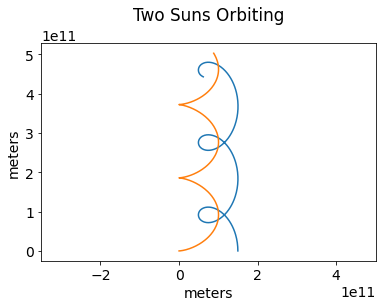

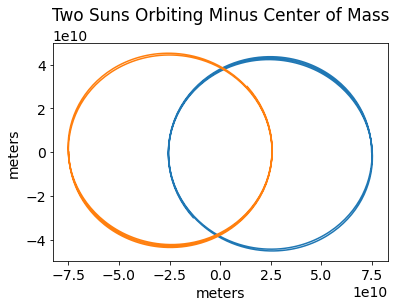

In [3]:
plt.axis('equal')
#Plot the two-body simulation both with and without the center of mass motion. 
params = dict()
params["initialPosition"] = np.array([SolarSystemParameters['EarthOrbitRadius'],0,0,0])
params["initialVelocity"] = np.array([0,SolarSystemParameters['EarthOrbitVelocity'],0, 0])
params["centralBodyMass"] = SolarSystemParameters["SunMass"]
params["orbitingBodyMass"] = SolarSystemParameters["SunMass"]
params["dt"] = 60*60*24
params["T"] = 60*60*24*365
params["initialTime"] = 0

def E(position, SolarSystemParameters, params):
    G = SolarSystemParameters["G"]
    M = params["centralBodyMass"]
    m = params["orbitingBodyMass"]
    E = (G*M*m)/ jnp.sqrt((position[0] - position[2])**2 + (position[1] - position[3])**2)
    return E
@jit
def F(position, SolarSystemParameters, params):
    return grad(E,0)(position, SolarSystemParameters, params)

def Step(time, position, velocity, SolarSystemParameters, params):
    m = params["orbitingBodyMass"]
    M = params["centralBodyMass"]
    dt = params["dt"]
    a = F(position, SolarSystemParameters, params) / jnp.array([m,m,M,M])
    
    positionMidPoint = position + velocity * dt/2
    velocityMidPoint = velocity + a*dt/2
    aMidPoint = F(positionMidPoint, SolarSystemParameters, params) / jnp.array([m,m,M,M])
    deltaPosition = velocityMidPoint * dt
    deltaVelocity = aMidPoint * dt
    new_time = time + dt
    new_position = position + deltaPosition
    new_velocity = velocity + deltaVelocity
    return (new_time,new_position,new_velocity)

def Orbit(SolarSystemParameters, params):
    initialPosition = params["initialPosition"]
    positions = []
    positions.append(initialPosition)
    initialVelocity = params["initialVelocity"]
    velocities = []
    velocities.append(initialVelocity)
    initialTime = params["initialTime"]
    times = []
    times.append(initialTime)
    dt = params["dt"]
    runTime = params["T"]
    for i in range(0, int(runTime/dt)):
          new_time, new_position, new_velocity = Step(times[i], positions[i], velocities[i], SolarSystemParameters, params)
          positions.append(new_position)
          times.append(new_time)
          velocities.append(new_velocity)
    return jnp.array(times),jnp.array(positions),jnp.array(velocities)

times, positions, velocities = Orbit(SolarSystemParameters, params)
M = SolarSystemParameters["SunMass"]
centerOfMass = np.array( [ ( (M*positions[:,0] + M*positions[:,2]) / (2*M) ), ( (M*positions[:,1] + M*positions[:,3]) / (2*M) ) ] )
plt.plot(positions[:,0], positions[:,1])
plt.plot(positions[:,2], positions[:,3])
plt.xlabel('meters')
plt.ylabel('meters')
plt.title('Two Suns Orbiting', pad = 23)
plt.show()
plt.plot(positions[:,0] - centerOfMass[0], positions[:,1] - centerOfMass[1])
plt.plot(positions[:,2] - centerOfMass[0], positions[:,3] - centerOfMass[1])
plt.xlabel('meters')
plt.ylabel('meters')
plt.title('Two Suns Orbiting Minus Center of Mass', pad = 23)
plt.show()

In [4]:
from matplotlib import animation
from IPython.display import HTML

from matplotlib.cm import get_cmap

name = "Accent"
cmap = get_cmap(name)  # type: matplotlib.colors.ListedColormap
colors = cmap.colors  # type: list

def animateMe(positions,fullLine=True):
    # First set up the figure, the axis, and the plot element we want to animate
    fig = plt.figure();
    x_min=np.min(list(positions[:,0])+list(positions[:,2]))*1.1
    x_max=np.max(list(positions[:,0])+list(positions[:,2]))*1.1
    y_min=np.min(list(positions[:,1])+list(positions[:,3]))*1.1
    y_max=np.max(list(positions[:,1])+list(positions[:,3]))*1.1
    ax = plt.axes(xlim=(x_min, x_max), ylim=(y_min, y_max));
    ax.set_prop_cycle(color=colors)
    line, = ax.plot([], [],'go', ms=10);


    plt.close(fig)
    # initialization function: plot the background of each frame
    def init():
        line.set_data([], [])
        return line,

    # animation function.  This is called sequentially
    def animate(i):

        x = positions[:,0]
        y = positions[:,1]
        ll=np.shape(positions)[1]
        xx=np.array(range(0,ll,2))
        yy=np.array(range(1,ll,2))
        if fullLine:
            line.set_data(positions[0:i,xx], positions[0:i,yy])
        else:
            line.set_data(positions[i,xx],positions[i,yy])
        return line,

    # call the animator.  blit=True means only re-draw the parts that have changed.

    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(positions), interval=20, 
                                   blit=True,repeat=False);
    return anim


anim=animateMe(positions[::1,:],False)
HTML(anim.to_jshtml())

### Cleaning up the mass

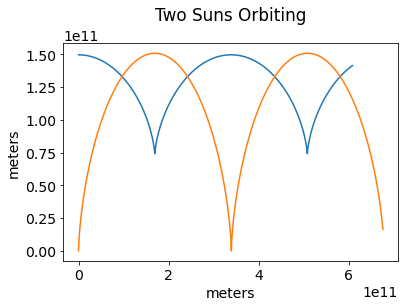

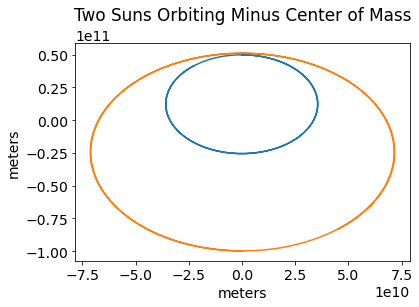

In [5]:
params["initialPosition"] = np.array([0,SolarSystemParameters['EarthOrbitRadius'],0,0])
params["initialVelocity"] = np.array([SolarSystemParameters['EarthOrbitVelocity'], 0,0,0])
params["centralBodyMass"] = .5*SolarSystemParameters["SunMass"]
params["orbitingBodyMass"] = SolarSystemParameters["SunMass"]
params["dt"] = 60*60*24
params["T"] = 60*60*24*365
params["initialTime"] = 0
times, positions, velocities = Orbit(SolarSystemParameters, params)


M = SolarSystemParameters["SunMass"]

centerOfMass = np.array( [ ( (M*positions[:,0] + .5*M*positions[:,2]) / (1.5*M) ), ( (M*positions[:,1] + .5*M*positions[:,3]) / (1.5*M) ) ] )

plt.plot(positions[:,0], positions[:,1])
plt.plot(positions[:,2], positions[:,3])
plt.xlabel('meters')
plt.ylabel('meters')
plt.title('Two Suns Orbiting', pad = 23)
plt.show()

plt.plot(positions[:,0] - centerOfMass[0], positions[:,1] - centerOfMass[1])
plt.plot(positions[:,2] - centerOfMass[0], positions[:,3] - centerOfMass[1])
plt.xlabel('meters')
plt.ylabel('meters')
plt.title('Two Suns Orbiting Minus Center of Mass', pad = 23)
plt.show()


## Three Planets

In [6]:
@jit
def E(position, SolarSystemParameters, params):
    G = SolarSystemParameters["G"]
    m = params["Masses"]
    energyFirstAndSecond = (G*m[0]*m[2]) / jnp.sqrt((position[0] - position[2])**2 + (position[1] - position[3])**2)
    energyFirstAndThird = (G*m[0]*m[4]) / jnp.sqrt((position[0] - position[4])**2 + (position[1] - position[5])**2)
    energySecondAndThird = (G*m[2]*m[4]) / jnp.sqrt((position[2] - position[4])**2 + (position[3] - position[5])**2)
    E = energyFirstAndSecond + energyFirstAndThird + energySecondAndThird
    return E

@jit
def F(position, SolarSystemParameters, params):
    return grad(E,0)(position, SolarSystemParameters, params)

def Step(time, position, velocity, SolarSystemParameters, params):
  m = params["Masses"]
  dt = params["dt"]
  a = F(position, SolarSystemParameters, params) / m
  
  positionMidPoint = position + velocity * dt/2
  velocityMidPoint = velocity + a*dt/2
  aMidPoint = F(positionMidPoint, SolarSystemParameters, params) / m
  deltaPosition = velocityMidPoint * dt
  deltaVelocity = aMidPoint * dt
  new_time = time + dt
  new_position = position + deltaPosition
  new_velocity = velocity + deltaVelocity
  return (new_time,new_position,new_velocity)

def Orbit(SolarSystemParameters, params):
    initialPosition = params["initialPosition"]
    positions = []
    positions.append(initialPosition)
    initialVelocity = params["initialVelocity"]
    velocities = []
    velocities.append(initialVelocity)
    initialTime = params["initialTime"]
    times = []
    times.append(initialTime)
    dt = params["dt"]
    runTime = params["T"]
    for i in range(0, int(runTime/dt)):
          new_time, new_position, new_velocity = Step(times[i], positions[i], velocities[i], SolarSystemParameters, params)
          positions.append(new_position)
          times.append(new_time)
          velocities.append(new_velocity)
    return jnp.array(times),jnp.array(positions),jnp.array(velocities)

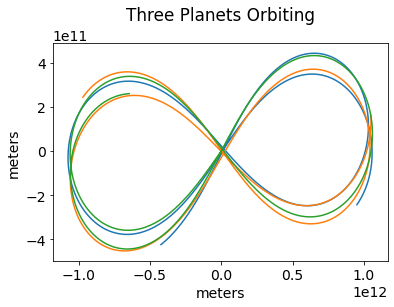

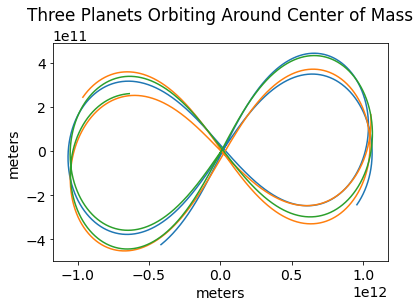

In [8]:

params["T"]=60.0*60.0*24.0*100.0
params["initialPosition"] = jnp.array([ 9.5000436e+11, -2.4308753e+11, -9.7000436e+11 , 2.4308753e+11, 0.0000000e+00,  0.0000000e+00])
params["initialVelocity"] = jnp.array([ 466203.685 , 432365.73 ,  466203.685  ,432365.73 , -932407.37 , -864731.48 ])
params["Masses"] = jnp.array([1.49925038e+34,1.49925038e+34,1.49925038e+34,1.49925038e+34,1.49925038e+34,1.49925038e+34])
params["dt"] = 60.0*60.0
params["initialTime"] = 0.0

times, positions, velocities = Orbit(SolarSystemParameters, params)

plt.plot(positions[:,0], positions[:,1])
plt.plot(positions[:,2], positions[:,3])
plt.plot(positions[:,4], positions[:,5])
plt.title("Three Planets Orbiting", pad = 23)
plt.xlabel('meters')
plt.ylabel('meters')
plt.show()

m = params["Masses"]
centerOfMass = jnp.array( [ (( (m[0]*positions[:,0] + m[2]*positions[:,2]) + m[4]*positions[:,4])/ (m[0] + m[2] + m[4])), ( (m[0]*positions[:,1] + m[2]*positions[:,3] + m[4]*positions[:,5]) / (m[0] + m[2] + m[4]) ) ] )
plt.plot(positions[:,0] - centerOfMass[0], positions[:,1] - centerOfMass[1])
plt.plot(positions[:,2] - centerOfMass[0], positions[:,3] - centerOfMass[1])
plt.plot(positions[:,4] - centerOfMass[0], positions[:,5] - centerOfMass[1])
plt.title("Three Planets Orbiting Around Center of Mass", pad = 23)
plt.xlabel('meters')
plt.ylabel('meters')
plt.show()

In [9]:


from matplotlib import animation
from IPython.display import HTML

from matplotlib.cm import get_cmap

name = "Accent"
cmap = get_cmap(name)  # type: matplotlib.colors.ListedColormap
colors = cmap.colors  # type: list

def animateMe(positions,fullLine=True):
    # First set up the figure, the axis, and the plot element we want to animate
    fig = plt.figure();
    x_min=np.min(list(positions[:,0])+list(positions[:,2]))*1.1
    x_max=np.max(list(positions[:,0])+list(positions[:,2]))*1.1
    y_min=np.min(list(positions[:,1])+list(positions[:,3]))*1.1
    y_max=np.max(list(positions[:,1])+list(positions[:,3]))*1.1
    ax = plt.axes(xlim=(x_min, x_max), ylim=(y_min, y_max));
    ax.set_prop_cycle(color=colors)
    line, = ax.plot([], [],'go', ms=10);


    plt.close(fig)
    # initialization function: plot the background of each frame
    def init():
        line.set_data([], [])
        return line,

    # animation function.  This is called sequentially
    def animate(i):

        x = positions[:,0]
        y = positions[:,1]
        ll=np.shape(positions)[1]
        xx=np.array(range(0,ll,2))
        yy=np.array(range(1,ll,2))
        if fullLine:
            line.set_data(positions[0:i,xx], positions[0:i,yy])
        else:
            line.set_data(positions[i,xx],positions[i,yy])
        return line,

    # call the animator.  blit=True means only re-draw the parts that have changed.

    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(positions), interval=20, 
                                   blit=True,repeat=False);
    return anim


stepSize=len(positions)//1000
anim=animateMe(positions[::stepSize,:],False)
HTML(anim.to_jshtml())

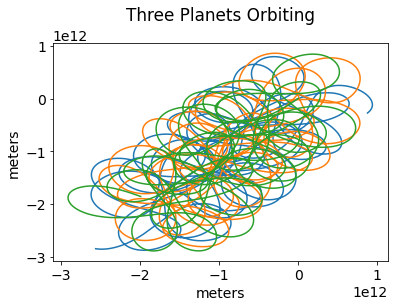

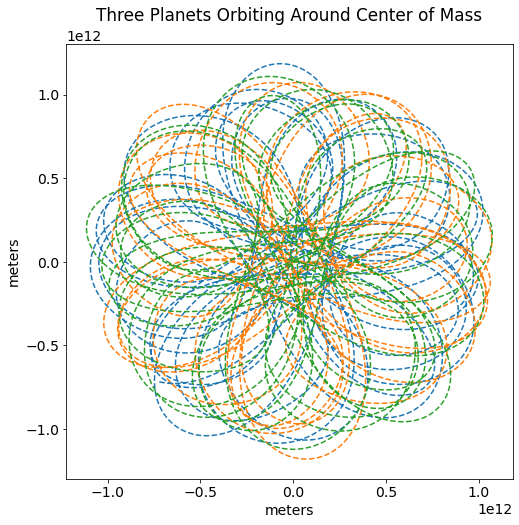

In [10]:
params["T"]=60.0*60.0*24.0*1000.0
params["initialPosition"] = jnp.array([ 8.75415651e+11, -2.74475729e+11, -9.55851880e+11 , 2.26509575e+11,0.00000000e+00,  0.00000000e+00])
params["initialVelocity"] = jnp.array([ 390853.52382274,  418580.80002714,  501291.7617827 ,  456901.09924283,-954861.69488255, -948996.44017539])
params["Masses"] = jnp.array([1.49925038e+34,1.49925038e+34,1.49925038e+34,1.49925038e+34,1.49925038e+34,1.49925038e+34])
params["dt"] = 60.0*60.0
params["initialTime"] = 0.0

times, positions, velocities = Orbit(SolarSystemParameters, params)

plt.plot(positions[:,0], positions[:,1])
plt.plot(positions[:,2], positions[:,3])
plt.plot(positions[:,4], positions[:,5])
plt.title("Three Planets Orbiting", pad = 23)
plt.xlabel('meters')
plt.ylabel('meters')
plt.show()

m = params["Masses"]
centerOfMass = jnp.array( [ (( (m[0]*positions[:,0] + m[2]*positions[:,2]) + m[4]*positions[:,4])/ (m[0] + m[2] + m[4])), ( (m[0]*positions[:,1] + m[2]*positions[:,3] + m[4]*positions[:,5]) / (m[0] + m[2] + m[4]) ) ] )
plt.plot(positions[:,0] - centerOfMass[0], positions[:,1] - centerOfMass[1], '--')
plt.plot(positions[:,2] - centerOfMass[0], positions[:,3] - centerOfMass[1], '--')
plt.plot(positions[:,4] - centerOfMass[0], positions[:,5] - centerOfMass[1], '--')
plt.title("Three Planets Orbiting Around Center of Mass", pad = 23)
plt.xlabel('meters')
plt.ylabel('meters')
orbit = plt.gcf()
orbit.set_size_inches(8, 8)
plt.show()

In [11]:


from matplotlib import animation
from IPython.display import HTML

from matplotlib.cm import get_cmap

name = "Accent"
cmap = get_cmap(name)  # type: matplotlib.colors.ListedColormap
colors = cmap.colors  # type: list

def animateMe(positions,fullLine=True):
    # First set up the figure, the axis, and the plot element we want to animate
    fig = plt.figure();
    x_min=np.min(list(positions[:,0])+list(positions[:,2]))*1.1
    x_max=np.max(list(positions[:,0])+list(positions[:,2]))*1.1
    y_min=np.min(list(positions[:,1])+list(positions[:,3]))*1.1
    y_max=np.max(list(positions[:,1])+list(positions[:,3]))*1.1
    ax = plt.axes(xlim=(x_min, x_max), ylim=(y_min, y_max));
    ax.set_prop_cycle(color=colors)
    line, = ax.plot([], [],'go', ms=10);


    plt.close(fig)
    # initialization function: plot the background of each frame
    def init():
        line.set_data([], [])
        return line,

    # animation function.  This is called sequentially
    def animate(i):

        x = positions[:,0]
        y = positions[:,1]
        ll=np.shape(positions)[1]
        xx=np.array(range(0,ll,2))
        yy=np.array(range(1,ll,2))
        if fullLine:
            line.set_data(positions[0:i,xx], positions[0:i,yy])
        else:
            line.set_data(positions[i,xx],positions[i,yy])
        return line,

    # call the animator.  blit=True means only re-draw the parts that have changed.

    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(positions), interval=20, 
                                   blit=True,repeat=False);
    return anim


stepSize=len(positions)//1000
anim=animateMe(positions[::stepSize,:],False)
HTML(anim.to_jshtml())

|planet|arc-seconds per century	| microradians per orbit|
|------|------------------------|-----------------------|
|Venus |280.6 |3.28|
|Earth |83.6 |0.98|
|Mars |2.6 |0.03|
|asteroids |not calculated <br />(perhaps ~0.13) |0.002|
|Jupiter |152.6 |1.78|
|Saturn |7.2 |0.08|
|Uranus|0.1 |0.001|
|Neptune|not calculated <br />(perhaps ~0.04) |0.0005|
|Pluto|Pluto was discovered in 1930. <br />(should be negligible)| |
|Total|526.7 |6.15|


## Mercury Precession

### Mercury without general relativity

In [12]:
resetMe(['SolarSystemParameters'])


def F(position, SolarSystemParameters, params):
    G = SolarSystemParameters["G"]
    x = position[0]
    y = position[1]
    m = SolarSystemParameters["MercuryMass"]
    M = SolarSystemParameters["SunMass"]
    ax = (-1 * G*M * x) / ( (x**2 + y**2)**(3/2))
    ay = (-1 * G*M * y) / ( (x**2 + y**2)**(3/2))
    force = np.array([m*ax, m*ay])
    return force

def Step(time, position, velocity, SolarSystemParameters, params):
  m = SolarSystemParameters["MercuryMass"]
  dt = params["dt"]
  a = F(position, SolarSystemParameters, params) / m
  
  positionMidPoint = position + velocity * dt/2
  velocityMidPoint = velocity + a*dt/2
  aMidPoint = F(positionMidPoint, SolarSystemParameters, params) / m
  deltaPosition = velocityMidPoint * dt
  deltaVelocity = aMidPoint * dt
  new_time = time + dt
  new_position = position + deltaPosition
  new_velocity = velocity + deltaVelocity
  return (new_time,new_position,new_velocity)

def Orbit(SolarSystemParameters, params):
    initialPosition = params["initialPosition"]
    positions = []
    positions.append(initialPosition)
    initialVelocity = params["initialVelocity"]
    velocities = []
    velocities.append(initialVelocity)
    initialTime = params["initialTime"]
    times = []
    times.append(initialTime)
    dt = params["dt"]
    runTime = params["T"]
    for i in range(0, int(runTime/dt)):
          new_time, new_position, new_velocity = Step(times[i], positions[i], velocities[i], SolarSystemParameters, params)
          positions.append(new_position)
          times.append(new_time)
          velocities.append(new_velocity)
    return np.array(times),np.array(positions),np.array(velocities)

def angle(line1, line2):
  theta = np.arccos(line1@line2/((np.linalg.norm(line1)*(np.linalg.norm(line2)))))
  return theta

def Perihelion(positions, SolarSystemParameters, params):
  numberOfSteps = len(positions) - 1
  minimumRadius = np.sqrt(positions[0][0]**2 + positions[0][1]**2) + 10
  maximumRadius = 0
  index = 0
  for i in range(int(.25*numberOfSteps), numberOfSteps, 1):
    newRadius = np.sqrt(positions[i][0]**2 + positions[i][1]**2)
    if (newRadius <= minimumRadius):
      minimumRadius = newRadius
      index = i
    if (newRadius >= maximumRadius):
      maximumRadius = newRadius
  print("The minimum distance without interpolation is:", minimumRadius, "meters")
  print("The maximum distance is:", maximumRadius, 'meters')
  positionsToExamine = positions[index-3:index+3]
  line=np.polyfit(np.double(positionsToExamine[:,0]), np.double(positionsToExamine[:,1]) ,2)
  f = np.poly1d(line)
  x = np.linspace(positionsToExamine[0][0], positionsToExamine[5][0], 100000)
  newX = 0
  newY = 0
  minimumRadius = np.sqrt(positions[0][0]**2 + positions[0][1]**2) + 10
  for i in range(len(x) - 1):
    y = f(x[i])
    minimumRadius2 = (y**2 + x[i]**2)**.5
    if (minimumRadius2 <= minimumRadius):
      newX = x[i]
      newY = y
      minimumRadius = minimumRadius2
  print('The minimum distance with interpolations is:', minimumRadius, "meters")
  oldPerihelion = np.array([positions[0][0], positions[0][1]])
  newPerihelion = np.array([newX, newY])
  print("The precession angle is:", angle(oldPerihelion, newPerihelion), "radians")



params = dict()
params["initialPosition"] = np.longdouble(np.array([0, 4.60012e10]))
params["initialVelocity"] = np.longdouble(np.array([5.898e4, 0]))
params["dt"] = np.longdouble(1.0)
params["T"] = np.longdouble(60*60*24*88*1.1)
params["initialTime"] = np.longdouble(0.0)

times, positions, velocities = Orbit(SolarSystemParameters, params)
Perihelion(positions, SolarSystemParameters, params)


The minimum distance without interpolation is: 46001200000.000168428 meters
The maximum distance is: 69831737676.059571795 meters
The minimum distance with interpolations is: 46001200000.00002289 meters
The precession angle is: 3.933666661743610588e-08 radians


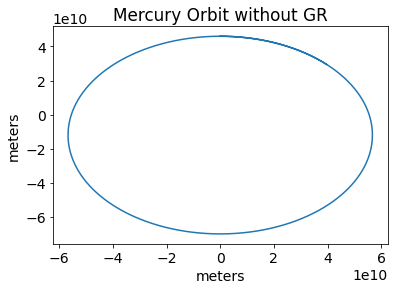

In [13]:
plt.plot(positions[:,0], positions[:,1])
plt.title("Mercury Orbit without GR")
plt.xlabel('meters')
plt.ylabel('meters')
plt.show()

### Mercury with general relativity

The minimum distance without interpolation is: 46001200003.72394126 meters
The maximum distance is: 69831723472.02026181 meters
The minimum distance with interpolations is: 46001199999.9980011 meters
The precession angle is: 4.959095947633747429e-07 radians


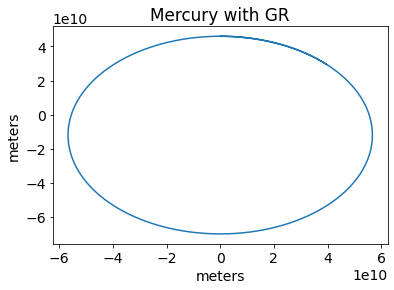

In [14]:
#Mercury with GR on
def F(position, SolarSystemParameters, params):
    G = SolarSystemParameters["G"]
    x = position[0]
    y = position[1]
    m = SolarSystemParameters["MercuryMass"]
    M = SolarSystemParameters["SunMass"]
    a = (-1*G*M / ( (x**2 + y**2)) + -1*( 3*2953.36 * (58980*4.60012e10)**2) / (2*(x**2 + y**2)**2)) * position/( (position[0]**2 + position[1]**2)**.5)
    force = m*a
    return force

params["initialPosition"] = np.longdouble(np.array([0, 4.60012e10]))
params["initialVelocity"] = np.longdouble(np.array([5.898e4, 0]))
params["dt"] = np.longdouble(60)
params["T"] = np.longdouble(60*60*24*88*1.1)
params["initialTime"] = np.longdouble(0)

times, positions, velocities = Orbit(SolarSystemParameters, params)
Perihelion(positions, SolarSystemParameters, params)
plt.plot(positions[:,0], positions[:,1])
plt.title("Mercury with GR")
plt.xlabel("meters")
plt.ylabel('meters')
plt.show()